<a href="https://colab.research.google.com/github/ivaben/DS-Unit-2-Applied-Modeling/blob/master/IVANA_BERNSTEIN_assignment_3_Applied_modeling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Lambda School Data Science

Unit 2, Sprint 3, Module 3

# Permutation & Boosting

You will use your portfolio project dataset for all assignments this sprint.

# Assignment

Complete these tasks for your project, and document your work.



 

 

 


1.   If you haven't completed assignment #1, please do so first.
2.   Continue to clean and explore your data. Make exploratory visualizations
3.    Fit a model. Does it beat your baseline?
4.   Try xgboost.
5. Get your model's permutation importances.


You should try to complete an initial model today, because the rest of the week, we're making model interpretation visualizations.

But, if you aren't ready to try xgboost and permutation importances with your dataset today, that's okay. You can practice with another dataset instead. You may choose any dataset you've worked with previously.

The data subdirectory includes the Titanic dataset for classification and the NYC apartments dataset for regression. You may want to choose one of these datasets, because example solutions will be available for each


**We recommend that you use your portfolio project dataset for all assignments this sprint.**

**But if you aren't ready yet, or you want more practice, then use the New York City property sales dataset for today's assignment.** Follow the instructions below, to just keep a subset for the Tribeca neighborhood, and remove outliers or dirty data. Here's a video walkthrough you can refer to if you get stuck or want hints!

# Reading


Top recommendations in bold italic:

Permutation Importances

Kaggle / Dan Becker: Machine Learning Explainability

Christoph Molnar: Interpretable Machine Learning

(Default) Feature Importances

Ando Saabas: Selecting good features, Part 3, Random Forests

Terence Parr, et al: Beware Default Random Forest Importances

Gradient Boosting

A Gentle Introduction to the Gradient Boosting Algorithm for Machine Learning

A Kaggle Master Explains Gradient Boosting

An Introduction to Statistical Learning Chapter 8

Gradient Boosting Explained

Boosting (2.5 minute video)

Data Source: NYC OpenData: NYC Citywide Rolling Calendar Sales

Glossary: NYC Department of Finance: Rolling Sales Data





In [0]:
!pip install category_encoders==2.*
!pip install pandas-profiling==2.*


     |████████████████████████████████| 102kB 3.6MB/s 
     |████████████████████████████████| 133kB 4.7MB/s 
     |████████████████████████████████| 614kB 40.6MB/s 
     |████████████████████████████████| 235kB 40.6MB/s 
     |████████████████████████████████| 307kB 51.4MB/s 
     |████████████████████████████████| 215kB 49.2MB/s 
     |████████████████████████████████| 51kB 7.8MB/s 
     |████████████████████████████████| 61kB 8.8MB/s 
     |████████████████████████████████| 737kB 53.3MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-2.3.0-py2.py3-none-any.whl size=145035 sha256=c7905858875178f484df2f05d9bbf0488241616763d8bfc355c4929dc51e5dda
  Stored in directory: /root/.cache/pip/wheels/ce/c7/f1/dbfef4848ebb048cb1d4a22d1ed0c62d8ff2523747235e19fe
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp36-none-any.whl size=27084 sha256=eaab14427463192c4ea53320e1068a423fea66de7de77ebc4f2fd466993683ea
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d

In [0]:

import warnings
warnings.filterwarnings(action='ignore', category=FutureWarning, module='numpy')

In [0]:
# Read NHL  data

import pandas as pd
import numpy as np


url = 'https://raw.githubusercontent.com/ivaben/unit-2-project/master/train.csv'

df = pd.read_csv (url, encoding='iso-8859-1')


In [0]:
df.head()

,Salary,Born,City,Pr/St,Cntry,Nat,Ht,Wt,DftYr,DftRd,Ovrl,Hand,Last Name,First Name,Position,Team,GP,G,A,A1,A2,PTS,+/-,E+/-,PIM,Shifts,TOI,TOIX,TOI/GP,TOI/GP.1,TOI%,IPP%,SH%,SV%,PDO,F/60,A/60,Pct%,Diff,Diff/60,...,Min,Maj,Match,Misc,Game,CF,CA,FF,FA,SF,SA,xGF,xGA,SCF,SCA,GF,GA,RBF,RBA,RSF,RSA,DSF,DSA,FOW,FOL,HF,HA,GVA,TKA,PENT,PEND,OPS,DPS,PS,OTOI,Grit,DAP,Pace,GS,GS/G
0,925000,97-01-30,Sainte-Marie,QC,CAN,CAN,74,190,2015.0,1.0,18.0,L,Chabot,Thomas,D,OTT,1,0,0,0,0,0,-2,0.0,0,13,429,7.2,7.15,7.16,15.2,0.0,0.0,0.750,750.0,0.00,16.74,0.0,-2,-16.74,...,0,0,0,0,0,9.0,12.0,8.0,10.0,5.0,8.0,0.5,0.9,2.0,3.0,0.0,2.0,1.0,1.0,0.0,1.0,1,2,4.0,5.0,1.0,2.0,1.0,1.0,1.0,1.0,0.0,-0.2,-0.2,40.03,1,0.0,175.7,-0.4,-0.38
1,2250000,93-12-21,Ottawa,ON,CAN,CAN,74,207,2012.0,1.0,15.0,R,Ceci,Cody,D,OTT,79,2,15,6,9,17,-11,-10.4,20,2418,109992,1826.2,23.20,23.17,39.0,30.4,7.4,0.915,989.0,1.84,2.79,39.7,-29,-0.95,...,10,0,0,0,0,1433.0,1992.0,1038.0,1423.0,757.0,997.0,62.0,88.8,197.0,280.0,56.0,85.0,68.0,82.0,79.0,94.0,147,176,949.0,939.0,749.0,671.0,284.0,197.0,104.0,98.0,-0.2,3.4,3.2,2850.59,290,13.3,112.5,14.1,0.18
2,8000000,88-04-16,St. Paul,MN,USA,USA,72,218,2006.0,1.0,7.0,R,Okposo,Kyle,RW,BUF,65,19,26,13,13,45,-7,-1.4,24,1443,73983,1229.2,18.97,18.95,33.1,63.4,9.7,0.934,1031.0,3.47,1.95,64.0,31,1.51,...,12,0,0,0,0,1301.0,1051.0,986.0,826.0,734.0,606.0,70.8,46.4,235.0,133.0,71.0,40.0,60.0,34.0,76.0,52.0,136,86,739.0,600.0,340.0,351.0,168.0,129.0,56.0,70.0,3.7,1.3,5.0,2486.75,102,6.6,114.8,36.8,0.57
3,3500000,92-01-07,Ottawa,ON,CAN,CAN,77,220,2010.0,1.0,3.0,R,Gudbranson,Erik,D,VAN,30,1,5,5,0,6,-14,-5.3,18,765,36603,607.9,20.33,20.31,36.1,37.5,6.2,0.897,959.0,1.58,3.45,31.4,-19,-1.88,...,4,2,0,0,0,460.0,605.0,339.0,467.0,259.0,340.0,22.0,33.6,80.0,130.0,16.0,35.0,27.0,20.0,29.0,32.0,56,52,324.0,328.0,198.0,197.0,86.0,59.0,26.0,22.0,0.0,0.4,0.5,1074.41,130,17.5,105.1,5.9,0.20
4,1750000,94-03-29,Toronto,ON,CAN,CAN,76,217,2012.0,1.0,16.0,R,Wilson,Tom,RW,WSH,82,7,12,4,8,19,9,4.1,133,1453,63592,1059.7,12.93,12.93,23.5,61.3,7.8,0.917,995.0,1.76,2.32,43.1,-10,-0.57,...,33,9,0,1,1,766.0,992.0,546.0,720.0,398.0,495.0,33.5,47.5,124.0,159.0,31.0,41.0,30.0,37.0,43.0,53.0,73,90,528.0,490.0,512.0,422.0,157.0,126.0,88.0,68.0,-0.1,1.4,1.3,3459.09,425,8.3,99.5,21.8,0.27


In [0]:
# Drop columns
columns = {'City', 'Pr/St', 'Cntry', 'Ht', 'Wt', '+/-',	'E+/-',	'PIM',	'Shifts', 'DftRd', 'Ovrl', 'First Name', 'FOW.Down', 'FOL.Down',
                               'FOW.Close', 'FOL.Close','G.Bkhd', 'G.Dflct', 'G.Slap', 'G.Snap', 'G.Tip', 'G.Wrap',
                                'G.Wrst', 'dzFOW', 'dzFOL', 'nzFOW', 'nzFOL','RSA', 'RSF', 'S.Bkhd', 'S.Dflct',
                               'S.Slap', 'S.Snap', 'S.Tip', 'S.Wrap', 'S.Wrst', 'FF',	'FA', 'iPenT', 'iPenD', 'iFOW.1',
                               'iFOL.1',
                               'iPENT', 'iPEND', 'iPenDf', 'NPD', 'Min',	'Maj',	'Match',	'Misc', 'Game', 'iHF.1', 'iGVA.1', 'iTKA.1', 'iBLK.1', 'BLK%',	}
df = df.drop(df[columns], axis = 1)

In [0]:
df.shape

(612, 98)

Your code starts here:

In [0]:
# Change column names: replace spaces with underscores

In [0]:
df.rename(columns={'Last Name':'Last_name','Nat':'Nationality', 'GP':'Games_played',
                   'G':'Goals','PTS':'Points','PIM':'Penalty_minutes', 'A':'Events_against_per_60_minutes', 
                   'A1':'Primary_assists', 'A2':'Secondary_Assists', 'TOI':'Time_on_ice', 
                   'IPP%':'Indiv_points' }, inplace=True)
df.head()

,Salary,Born,Nationality,DftYr,Hand,Last_name,Position,Team,Games_played,Goals,Events_against_per_60_minutes,Primary_assists,Secondary_Assists,Points,Time_on_ice,TOIX,TOI/GP,TOI/GP.1,TOI%,Indiv_points,SH%,SV%,PDO,F/60,A/60,Pct%,Diff,Diff/60,iCF,iCF.1,iFF,iSF,iSF.1,iSF.2,ixG,iSCF,iRB,iRS,iDS,sDist,...,1G,GWG,ENG,PSG,PSA,CBar,Post,Over,Wide,CF,CA,SF,SA,xGF,xGA,SCF,SCA,GF,GA,RBF,RBA,DSF,DSA,FOW,FOL,HF,HA,GVA,TKA,PENT,PEND,OPS,DPS,PS,OTOI,Grit,DAP,Pace,GS,GS/G
0,925000,97-01-30,CAN,2015.0,L,Chabot,D,OTT,1,0,0,0,0,0,429,7.2,7.15,7.16,15.2,0.0,0.0,0.750,750.0,0.00,16.74,0.0,-2,-16.74,2.0,2,2.0,1.0,1,1,0.0,0.0,0.0,0.0,0.0,43.0,...,0,0,0,0,0,0,0,0,1,9.0,12.0,5.0,8.0,0.5,0.9,2.0,3.0,0.0,2.0,1.0,1.0,1,2,4.0,5.0,1.0,2.0,1.0,1.0,1.0,1.0,0.0,-0.2,-0.2,40.03,1,0.0,175.7,-0.4,-0.38
1,2250000,93-12-21,CAN,2012.0,R,Ceci,D,OTT,79,2,15,6,9,17,109992,1826.2,23.20,23.17,39.0,30.4,7.4,0.915,989.0,1.84,2.79,39.7,-29,-0.95,287.0,287,197.0,143.0,143,143,6.1,7.0,7.0,9.0,16.0,52.4,...,0,0,0,0,0,0,1,2,51,1433.0,1992.0,757.0,997.0,62.0,88.8,197.0,280.0,56.0,85.0,68.0,82.0,147,176,949.0,939.0,749.0,671.0,284.0,197.0,104.0,98.0,-0.2,3.4,3.2,2850.59,290,13.3,112.5,14.1,0.18
2,8000000,88-04-16,USA,2006.0,R,Okposo,RW,BUF,65,19,26,13,13,45,73983,1229.2,18.97,18.95,33.1,63.4,9.7,0.934,1031.0,3.47,1.95,64.0,31,1.51,283.0,283,212.0,155.0,156,156,17.4,64.0,16.0,20.0,36.0,28.4,...,5,2,0,0,0,0,2,4,51,1301.0,1051.0,734.0,606.0,70.8,46.4,235.0,133.0,71.0,40.0,60.0,34.0,136,86,739.0,600.0,340.0,351.0,168.0,129.0,56.0,70.0,3.7,1.3,5.0,2486.75,102,6.6,114.8,36.8,0.57
3,3500000,92-01-07,CAN,2010.0,R,Gudbranson,D,VAN,30,1,5,5,0,6,36603,607.9,20.33,20.31,36.1,37.5,6.2,0.897,959.0,1.58,3.45,31.4,-19,-1.88,88.0,88,55.0,40.0,40,40,1.4,2.0,1.0,4.0,5.0,55.1,...,0,1,0,0,0,0,0,0,15,460.0,605.0,259.0,340.0,22.0,33.6,80.0,130.0,16.0,35.0,27.0,20.0,56,52,324.0,328.0,198.0,197.0,86.0,59.0,26.0,22.0,0.0,0.4,0.5,1074.41,130,17.5,105.1,5.9,0.20
4,1750000,94-03-29,CAN,2012.0,R,Wilson,RW,WSH,82,7,12,4,8,19,63592,1059.7,12.93,12.93,23.5,61.3,7.8,0.917,995.0,1.76,2.32,43.1,-10,-0.57,166.0,166,118.0,95.0,95,95,9.3,35.0,8.0,10.0,18.0,30.9,...,2,0,1,0,0,0,2,1,20,766.0,992.0,398.0,495.0,33.5,47.5,124.0,159.0,31.0,41.0,30.0,37.0,73,90,528.0,490.0,512.0,422.0,157.0,126.0,88.0,68.0,-0.1,1.4,1.3,3459.09,425,8.3,99.5,21.8,0.27


In [0]:
df.columns

Index(['Salary', 'Born', 'Nationality', 'DftYr', 'Hand', 'Last_name',
       'Position', 'Team', 'Games_played', 'Goals',
       'Events_against_per_60_minutes', 'Primary_assists', 'Secondary_Assists',
       'Points', 'Time_on_ice', 'TOIX', 'TOI/GP', 'TOI/GP.1', 'TOI%',
       'Indiv_points', 'SH%', 'SV%', 'PDO', 'F/60', 'A/60', 'Pct%', 'Diff',
       'Diff/60', 'iCF', 'iCF.1', 'iFF', 'iSF', 'iSF.1', 'iSF.2', 'ixG',
       'iSCF', 'iRB', 'iRS', 'iDS', 'sDist', 'sDist.1', 'Pass', 'iHF', 'iHA',
       'iHDf', 'iMiss', 'iGVA', 'iTKA', 'iBLK', 'iFOW', 'iFOL', 'FO%', '%FOT',
       'ozFOW', 'ozFOL', 'FOW.Up', 'FOL.Up', 'OTG', '1G', 'GWG', 'ENG', 'PSG',
       'PSA', 'CBar ', 'Post', 'Over', 'Wide', 'CF', 'CA', 'SF', 'SA', 'xGF',
       'xGA', 'SCF', 'SCA', 'GF', 'GA', 'RBF', 'RBA', 'DSF', 'DSA', 'FOW',
       'FOL', 'HF', 'HA', 'GVA', 'TKA', 'PENT', 'PEND', 'OPS', 'DPS', 'PS',
       'OTOI', 'Grit', 'DAP', 'Pace', 'GS', 'GS/G'],
      dtype='object')

In [0]:
# Get Pandas Profiling Report
import pandas_profiling

profile_report = df.profile_report(
    check_correlation_pearson=False,
    correlations={
        'pearson': False,
        'spearman': False,
        'kendall': False,
        'phi_k': False,
        'cramers': False,
        'recoded': False,
    },
    plot={'histogram': {'bayesian_blocks_bins': False}},
)

profile_report

In [0]:
# Look how many rows you have?
df.shape

(612, 98)

In [0]:
df.fillna(0,inplace=True)

In [0]:
# The Pandas Profiling Report showed that SALE_PRICE was read as strings
# Convert it to integers

df['Salary'].dtypes

dtype('int64')

In [0]:
# Q. What is the maximum Salary in this dataset?
pd.options.display.float_format = '{:,.0f}'.format
df['Salary'].describe()

count          612
mean     2,264,509
std      2,236,340
min        575,000
25%        742,500
50%        925,000
75%      3,500,000
max     13,800,000
Name: Salary, dtype: float64

In [0]:
# Look at the row with the max Salary
import numpy as np

print(df[df.Salary == df.Salary.max()]) 

       Salary      Born Nationality  DftYr Hand  ... Grit DAP Pace  GS  GS/G
103  13800000  88-11-19         USA  2,007    L  ...   75   5  114  89     1
496  13800000  88-04-29         CAN  2,006    L  ...  111   5  117  62     1

[2 rows x 98 columns]


In [0]:
# Get value counts of TOTAL_UNITS
# Q. How many property sales were for multiple units?

target = 'Salary'
df[target].value_counts(normalize=False)

925000     80
575000     39
600000     29
4000000    20
5000000    19
           ..
3275000     1
850000      1
620000      1
2825000     1
7500000     1
Name: Salary, Length: 138, dtype: int64

In [0]:
features = ['Born', 'Nationality', 'DftYr', 'Hand', 'Last_name',
       'Position', 'Team', 'Games_played', 'Goals',
       'Events_against_per_60_minutes', 'Primary_assists', 'Secondary_Assists',
       'Points', 'Time_on_ice', 'TOIX', 'TOI/GP', 'TOI/GP.1', 'TOI%',
       'Indiv_points', 'SH%', 'SV%', 'PDO', 'F/60', 'A/60', 'Pct%', 'Diff',
       'Diff/60', 'iCF', 'iCF.1', 'iFF', 'iSF', 'iSF.1', 'iSF.2', 'ixG',
       'iSCF', 'iRB', 'iRS', 'iDS', 'sDist', 'sDist.1', 'Pass', 'iHF', 'iHA',
       'iHDf', 'iMiss', 'iGVA', 'iTKA', 'iBLK', 'iFOW', 'iFOL', 'FO%', '%FOT',
       'ozFOW', 'ozFOL', 'FOW.Up', 'FOL.Up', 'OTG', '1G', 'GWG', 'ENG', 'PSG',
       'PSA', 'CBar_', 'Post', 'Over', 'Wide', 'CF', 'CA', 'SF', 'SA', 'xGF',
       'xGA', 'SCF', 'SCA', 'GF', 'GA', 'RBF', 'RBA', 'DSF', 'DSA', 'FOW',
       'FOL', 'HF', 'HA', 'GVA', 'TKA', 'PENT', 'PEND', 'OPS', 'DPS', 'PS',
       'OTOI', 'Grit', 'DAP', 'Pace', 'GS', 'GS/G']

target = 'Salary'

train = [features] + [target]


# Which column in your tabular dataset will you predict?

In [0]:
target = 'Salary'

# How is your target distributed?

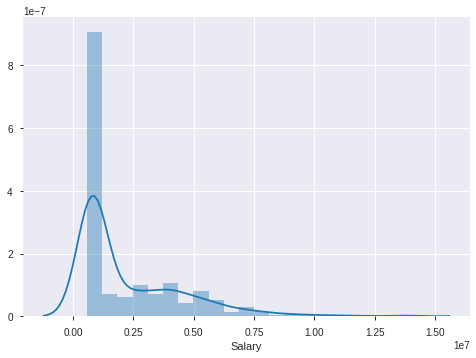

In [0]:
import seaborn as sns
sns.distplot(df[target]);

# Log-Transform

If the target is right-skewed, you may want to "log transform" the target.



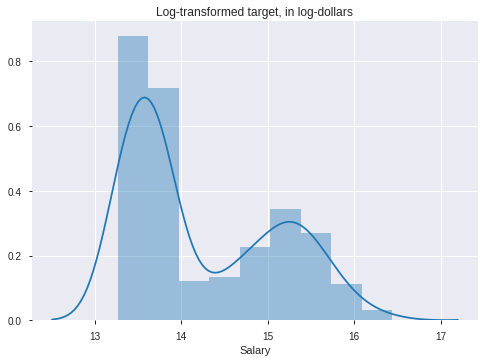

In [0]:
import numpy as np
import matplotlib.pyplot as plt
y_log = np.log1p(df[target])

sns.distplot(y_log)
plt.title('Log-transformed target, in log-dollars');

# Choose your evaluation metric(s)

Regression: Will you use mean absolute error, root mean squared error, R^2, or other regression metrics?

# 1. Begin with baselines for regression

In [0]:
pd.options.display.float_format = '{:,.0f}'.format
df['Salary'].describe()

count          612
mean     2,264,509
std      2,236,340
min        575,000
25%        742,500
50%        925,000
75%      3,500,000
max     13,800,000
Name: Salary, dtype: float64

Avarage salary in NHL per player is $2,3 million . So that could be a reasonable first guess.

In [0]:
guess = df['Salary'].mean()
errors = guess - df['Salary']
mean_absolute_error = errors.abs().mean()

In [0]:
print(f'If we just guessed that every player in NHL earn ${guess:,.0f},')
print(f'we would be off by ${mean_absolute_error:,.0f} on average.')

If we just guessed that every player in NHL earn $2,264,509,
we would be off by $1,775,263 on average.


# 2. Predictive Model

In [0]:
# Make a Plotly Express scatter plot of Goals vs Salary

import plotly.express as px
px.scatter(df, x="Goals", y="Salary"
           , trendline='ols', color='Salary',
           title='Comparasion: Salary vs. Goals'
           
           , template='plotly_dark'
          )

# 3. Follow the 5 step process, and refer to Scikit-Learn LinearRegression documentation.

Linear Regression with one feature

In [0]:
# 1. Import the appropriate estimator class from Scikit-Learn
from sklearn.linear_model import LinearRegression

# 2. Instantiate this class
model = LinearRegression()

# 3. Arrange X features matrix & y target vector
features = ['Goals']
target = 'Salary'
X_train = df[features]
y_train = df[target]

# 4. Fit the model
model.fit(X_train, y_train)


LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [0]:
# 5. Apply the model to new data
goals = 20
X_test = [[goals]]
y_pred = model.predict(X_test)

y_pred

array([3965759.35443263])

# we'll look at the coef_ and intercept_ attributes of the LinearRegression object.

In [0]:
model.coef_

array([138803.53951643])

In [0]:
model.intercept_

1189688.564103952

In [0]:
# Equations for a line
m = model.coef_[0]
b = model.intercept_

In [0]:
print('y = mx + b')
print(f'y = {m:,.0f}*x + {b:,.0f}')
print(f'Salary = {m:,.0f} * Goals + {b:,.0f}')

y = mx + b
y = 138,804*x + 1,189,689
Salary = 138,804 * Goals + 1,189,689


In [0]:
def predict(goals):
    y_pred = model.predict([[goals]])
    estimate = y_pred[0]
    coefficient = model.coef_[0]
    result = f'${estimate:,.0f} estimated salary for {goals:,.0f} goals.' 
    explanation = f'In this linear regression, each additional goal adds ${coefficient:,.0f}.'
    return result + '\n' + explanation

print(predict(20))

$3,965,759 estimated salary for 20 goals.
In this linear regression, each additional goal adds $138,804.


In [0]:
# What does the model predict not to many shooted goals?
print(predict(5))

$1,883,706 estimated salary for 5 goals.
In this linear regression, each additional goal adds $138,804.


# Use scikit-learn to fit a multiple regression

1. **Do** **train/test split** **bold text**

In [0]:
from sklearn.model_selection import train_test_split
train, test = train_test_split(df, random_state=42)
train.shape, test.shape

((459, 98), (153, 98))

In [0]:
df['Born'] = pd.to_datetime(df['Born'], infer_datetime_format=True)


2. **Explore & clean your data**

In [0]:
import pandas_profiling
train.profile_report()

OTG - Overtime Goals has 83% zeros
therefore we will deal with zeros

In [0]:
df = train.head().copy()

In [0]:
df = test.head().copy()

In [0]:
# Treat zeros like null values. 
# Replace in both sets with the mean from the training set.
train['OTG'] = train['OTG'].replace(0, train['OTG'].mean())
test['OTG'] = test['OTG'].replace(0, train['OTG'].mean())

In [0]:
# Split train into train & val
train, val = train_test_split(train,
                              random_state=42)

train.shape, val.shape, test.shape

((344, 98), (115, 98), (153, 98))

# Permutation and Boosting

In [0]:
# Permutation and Boosting

In [0]:
# Arrange data into X features matrix and y target vector
target = 'Salary'
X_train = train.drop(columns=target)
y_train = train[target]
X_val = val.drop(columns=target)
y_val = val[target]
X_test = test

In [0]:
import category_encoders as ce
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline

pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='median'), 
    RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1)
)

# Fit on train, score on val
pipeline.fit(X_train, y_train)
print('Validation Accuracy', pipeline.score(X_val, y_val))

Validation Accuracy 0.19130434782608696


# 1. (Default) Feature Importances

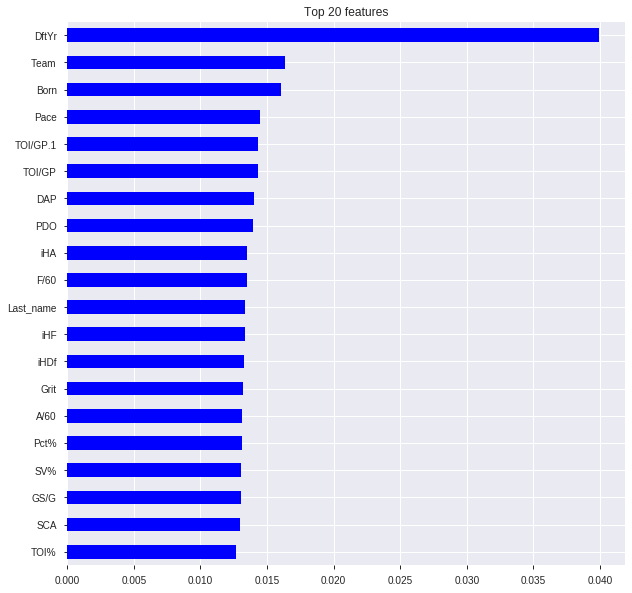

In [0]:
# Get feature importances
rf = pipeline.named_steps['randomforestclassifier']
importances = pd.Series(rf.feature_importances_, X_train.columns)

# Plot feature importances
%matplotlib inline
import matplotlib.pyplot as plt

n = 20
plt.figure(figsize=(10,n/2))
plt.title(f'Top {n} features')
importances.sort_values()[-n:].plot.barh(color='blue');

# 2. Drop-Column Importance

In [0]:
column  = 'Points'

# Fit without column
pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='median'), 
    RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1)
)
pipeline.fit(X_train.drop(columns=column), y_train)
score_without = pipeline.score(X_val.drop(columns=column), y_val)
print(f'Validation Accuracy without {column}: {score_without}')

# Fit with column
pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='median'), 
    RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1)
)
pipeline.fit(X_train, y_train)
score_with = pipeline.score(X_val, y_val)
print(f'Validation Accuracy with {column}: {score_with}')

# Compare the error with & without column
print(f'Drop-Column Importance for {column}: {score_with - score_without}')

Validation Accuracy without Points: 0.1391304347826087
Validation Accuracy with Points: 0.19130434782608696
Drop-Column Importance for Points: 0.052173913043478265


# 3. Permutation Importance

In [0]:
# BEFORE: Sequence of the feature to be permuted
feature = 'Points'
X_val[feature].head()

319    53
412    13
150    65
191    42
515    20
Name: Points, dtype: int64

In [0]:
# BEFORE: Distribution of the feature to be permuted
X_val[feature].value_counts()

0     13
1      5
24     5
28     5
25     5
8      4
7      3
35     3
13     3
10     3
12     3
26     3
2      3
6      3
3      3
61     3
17     2
23     2
31     2
20     2
4      2
53     2
55     2
44     2
19     1
15     1
14     1
21     1
5      1
11     1
9      1
16     1
86     1
27     1
48     1
69     1
66     1
65     1
64     1
62     1
59     1
52     1
50     1
49     1
47     1
85     1
45     1
43     1
42     1
41     1
38     1
37     1
36     1
34     1
32     1
30     1
Name: Points, dtype: int64

In [0]:
# PERMUTE!
X_val_permuted = X_val.copy()
X_val_permuted[feature] = np.random.permutation(X_val[feature])

In [0]:
# AFTER: Sequence has changed
X_val_permuted[feature].head()

319     5
412    12
150    50
191    13
515    44
Name: Points, dtype: int64

In [0]:
# AFTER: Distribution hasn't changed!
X_val_permuted[feature].value_counts()

0     13
1      5
24     5
28     5
25     5
8      4
7      3
35     3
13     3
10     3
12     3
26     3
2      3
6      3
3      3
61     3
17     2
23     2
31     2
20     2
4      2
53     2
55     2
44     2
19     1
15     1
14     1
21     1
5      1
11     1
9      1
16     1
86     1
27     1
48     1
69     1
66     1
65     1
64     1
62     1
59     1
52     1
50     1
49     1
47     1
85     1
45     1
43     1
42     1
41     1
38     1
37     1
36     1
34     1
32     1
30     1
Name: Points, dtype: int64

In [0]:
# Get the permutation importance
# Notice that we don't need to refit here!
score_permuted = pipeline.score(X_val_permuted, y_val)

print(f'Validation accuracy with {feature}: {score_with}')
print(f'Validation accuracy with {feature} permuted: {score_permuted}')
print(f'Permutation importance: {score_with - score_permuted}')

Validation accuracy with Points: 0.19130434782608696
Validation accuracy with Points permuted: 0.19130434782608696
Permutation importance: 0.0


In [0]:
# Rerun the permutation importance process, but for a different feature
feature = 'Goals'
X_val_permuted = X_val.copy()
X_val_permuted[feature] = np.random.permutation(X_val[feature])
score_permuted = pipeline.score(X_val_permuted, y_val)

print(f'Validation accuracy with {feature}: {score_with}')
print(f'Validation accuracy with {feature} permuted: {score_permuted}')
print(f'Permutation importance: {score_with - score_permuted}')

Validation accuracy with Goals: 0.19130434782608696
Validation accuracy with Goals permuted: 0.19130434782608696
Permutation importance: 0.0


# With eli5 library

In [0]:
transformers = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='median')
)

In [0]:
X_train_transformed = transformers.fit_transform(X_train)
X_val_transformed = transformers.transform(X_val)

model = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1)
model.fit(X_train_transformed, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)

In [0]:
!pip install eli5
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()
import eli5
from eli5.sklearn import PermutationImportance





In [0]:
# 1. Calculate permutation importances
permuter = PermutationImportance(
    model, 
    scoring='accuracy', 
    n_iter=5, 
    random_state=42
)

permuter.fit(X_val_transformed, y_val)

PermutationImportance(cv='prefit',
                      estimator=RandomForestClassifier(bootstrap=True,
                                                       class_weight=None,
                                                       criterion='gini',
                                                       max_depth=None,
                                                       max_features='auto',
                                                       max_leaf_nodes=None,
                                                       min_impurity_decrease=0.0,
                                                       min_impurity_split=None,
                                                       min_samples_leaf=1,
                                                       min_samples_split=2,
                                                       min_weight_fraction_leaf=0.0,
                                                       n_estimators=100,
                                                     

# Use xgboost for gradient boosting

In [0]:
from xgboost import XGBClassifier

pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    XGBClassifier(n_estimators=100, random_state=42, n_jobs=-1)
)

pipeline.fit(X_train, y_train)

Pipeline(memory=None,
         steps=[('ordinalencoder',
                 OrdinalEncoder(cols=['Born', 'Nationality', 'Hand',
                                      'Last_name', 'Position', 'Team'],
                                drop_invariant=False, handle_missing='value',
                                handle_unknown='value',
                                mapping=[{'col': 'Born',
                                          'data_type': dtype('O'),
                                          'mapping': 91-11-01      1
93-07-12      2
89-07-05      3
97-05-26      4
92-04-20      5
           ... 
95-02-09    330
94-05-25    331
92-11-24    332
88-04-20    333
NaN          -2
Leng...
                 XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, gamma=0, learning_rate=0.1,
                               max_delta_step=0, max_depth=3,
                             

In [0]:
from sklearn.metrics import accuracy_score
y_pred = pipeline.predict(X_val)
print('Validation Accuracy', accuracy_score(y_val, y_pred))

Validation Accuracy 0.1391304347826087
